In [ ]:
!pip install -r notebook_requirements.txt

In [1]:
%matplotlib inline 

import joblib
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import requests

In [2]:
URL = "http://localhost:8000/search"
N_IMAGES = 5
MAPPING = joblib.load("../resources/mapping.joblib")

In [3]:
def show_results_for_query(query):
    response = requests.get(url=URL, params= {"query": query}).json()
    image_ids = [item["id"] for item in response]
    scores = [item["score"] for item in response]
    files = [MAPPING[image_id] for image_id in image_ids]

    _, axs = plt.subplots(1, N_IMAGES, figsize=(20, 10), tight_layout=True)

    for ax, image_path, image_id, score in zip(axs, files, image_ids, scores):
        img = mpimg.imread(os.path.join("..", image_path))
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(f"{image_path} \n id={image_id} \n score={round(score, 3)}") 
    plt.show()

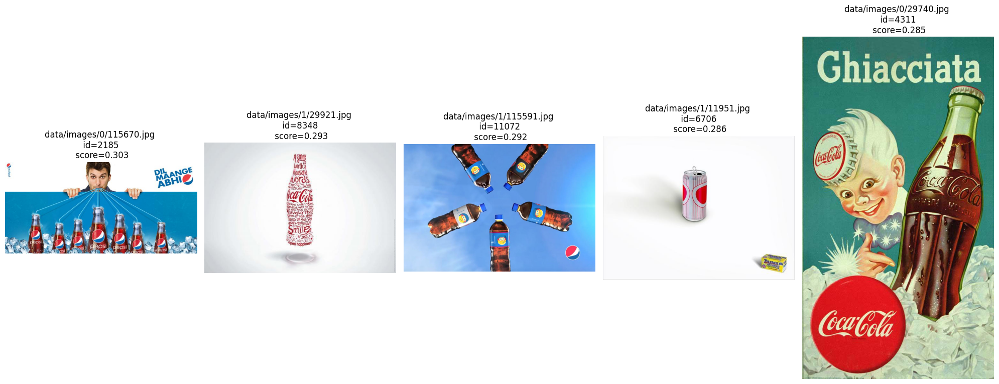

In [4]:
show_results_for_query("soda")

## Examples

### Good

#### Food & Drinks

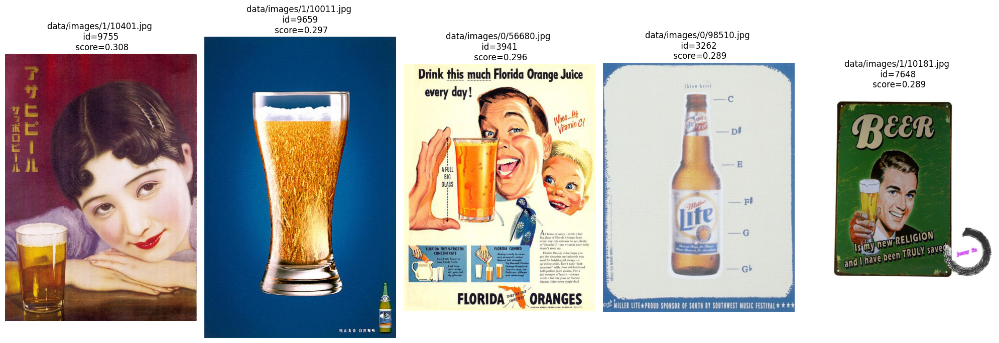

In [5]:
show_results_for_query("beer")

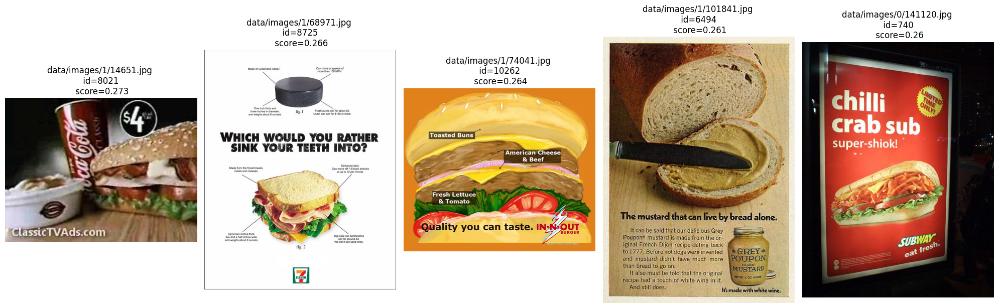

In [6]:
show_results_for_query("sandwich")

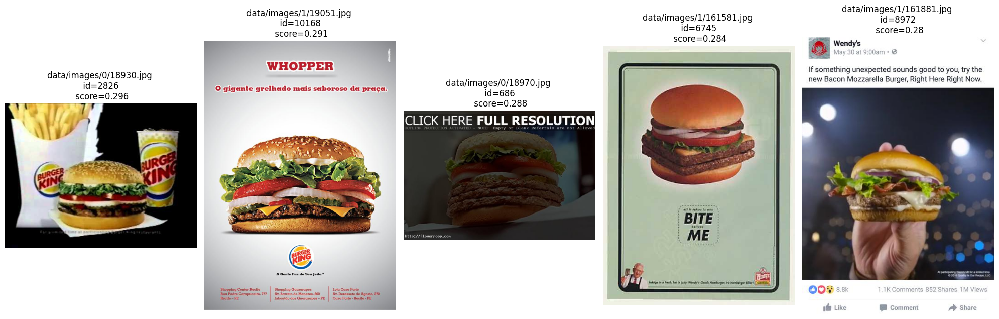

In [7]:
show_results_for_query("burger")

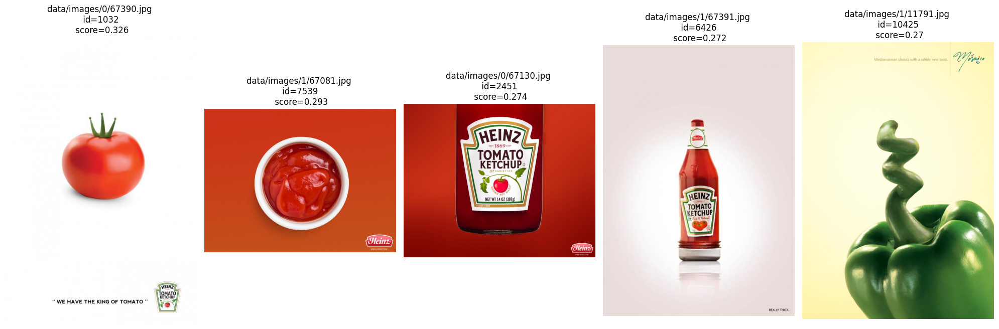

In [8]:
show_results_for_query("tomato")

#### Brands & text
The model works well for recognizing text and brands in the pictures

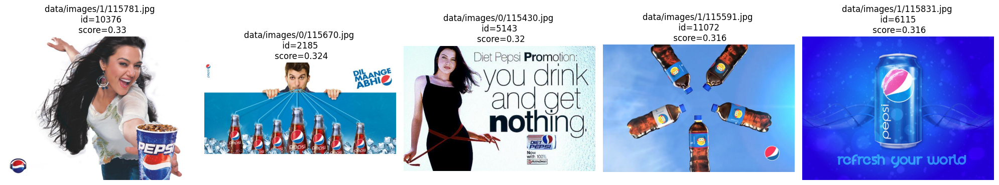

In [9]:
show_results_for_query("pepsi")

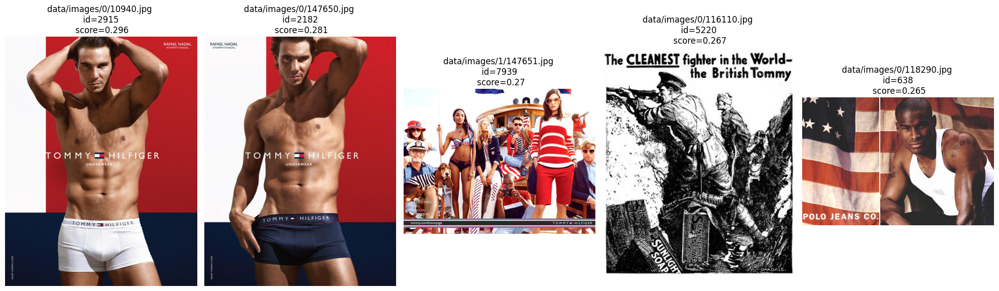

In [10]:
show_results_for_query("tommy")

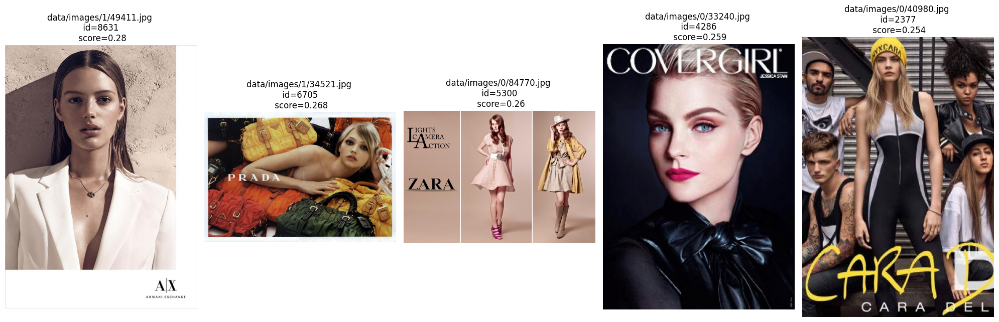

In [11]:
show_results_for_query("zara")

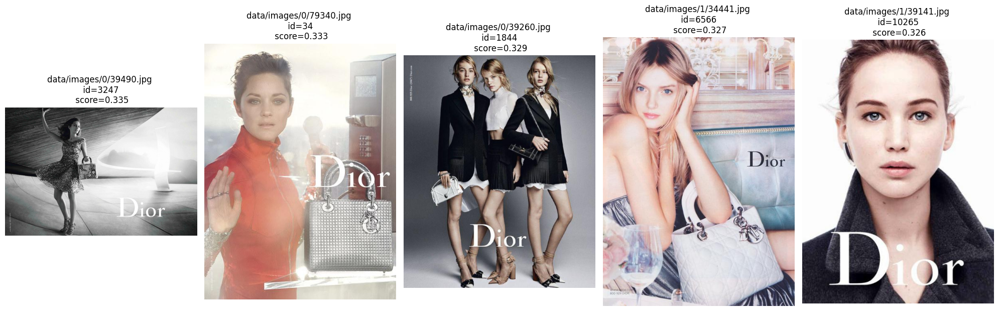

In [12]:
show_results_for_query("dior")

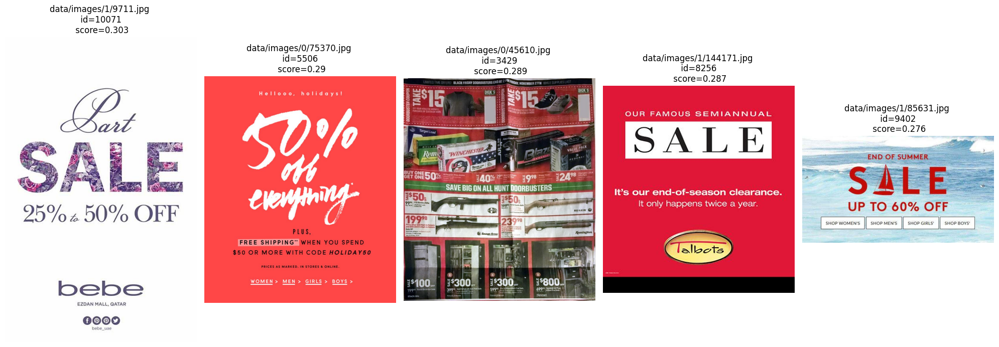

In [13]:
show_results_for_query("sale")

#### Other

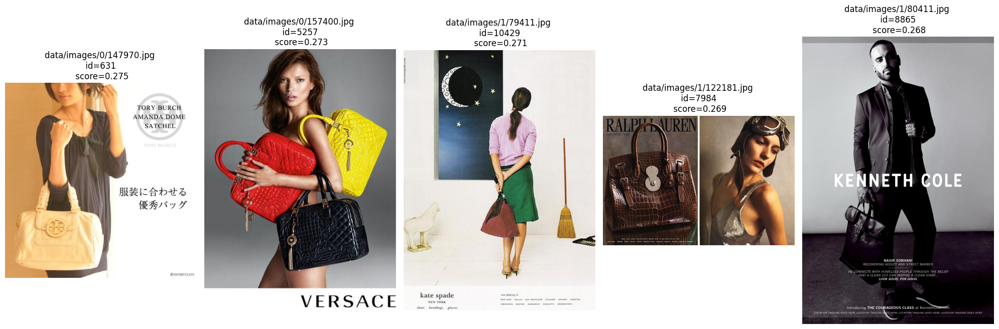

In [14]:
show_results_for_query("leather bag")

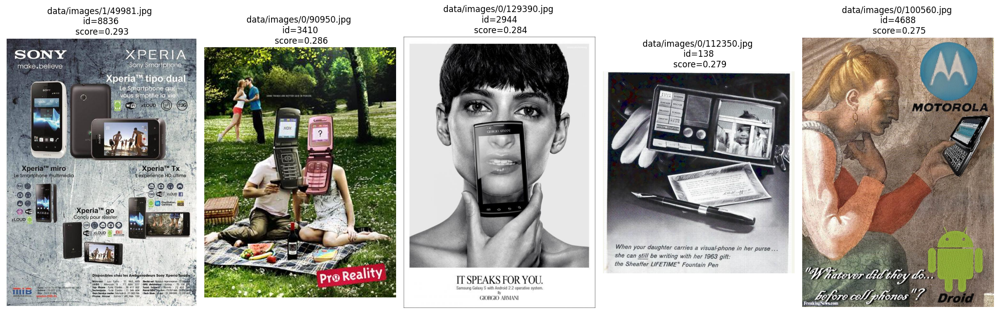

In [15]:
show_results_for_query("smartphone")

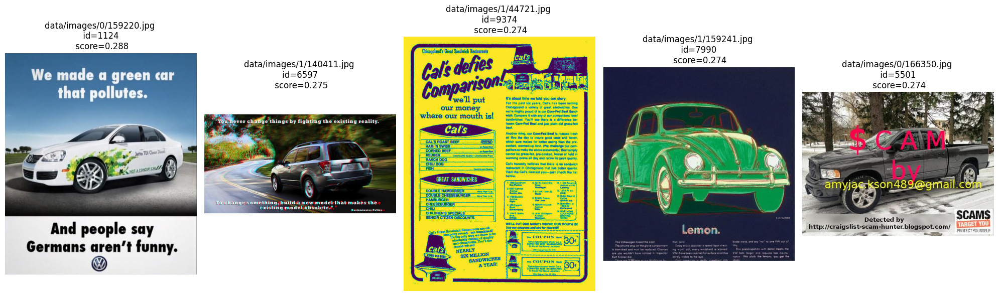

In [16]:
show_results_for_query("car")

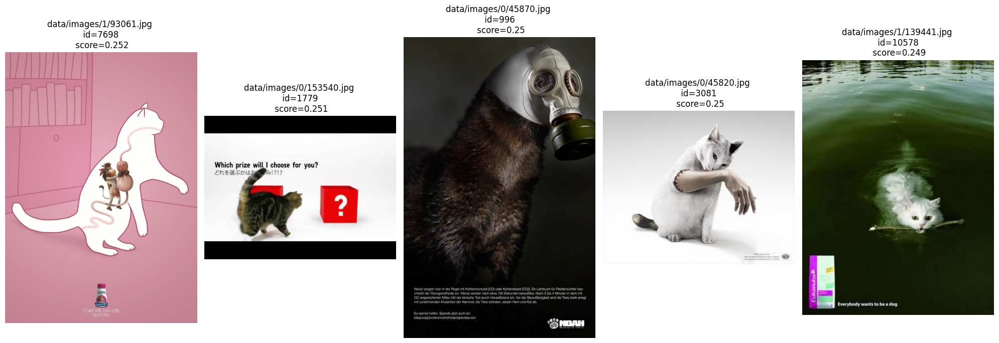

In [17]:
show_results_for_query("cat")

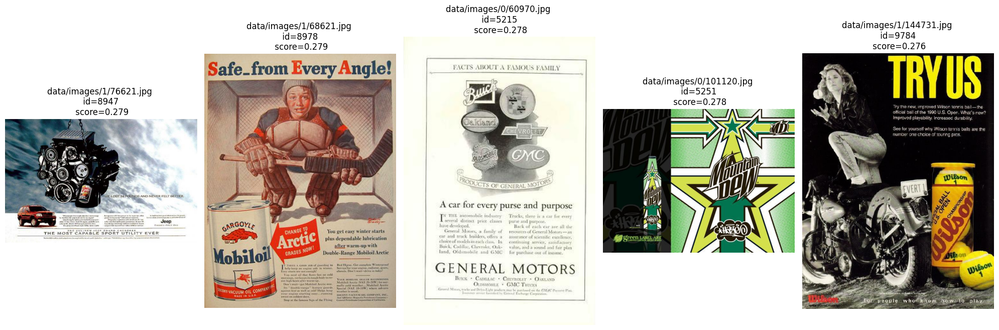

In [18]:
show_results_for_query("motor oil")

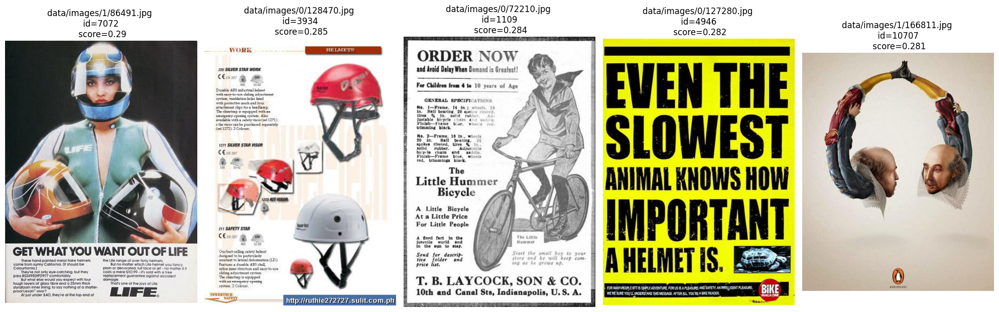

In [19]:
show_results_for_query("bike helmet")

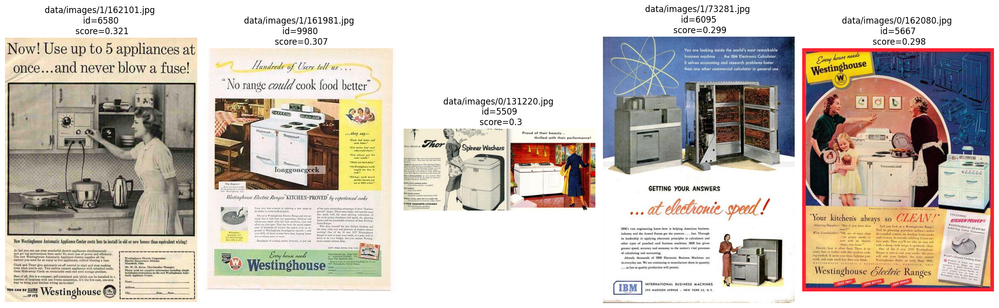

In [20]:
show_results_for_query("kitchen appliances")

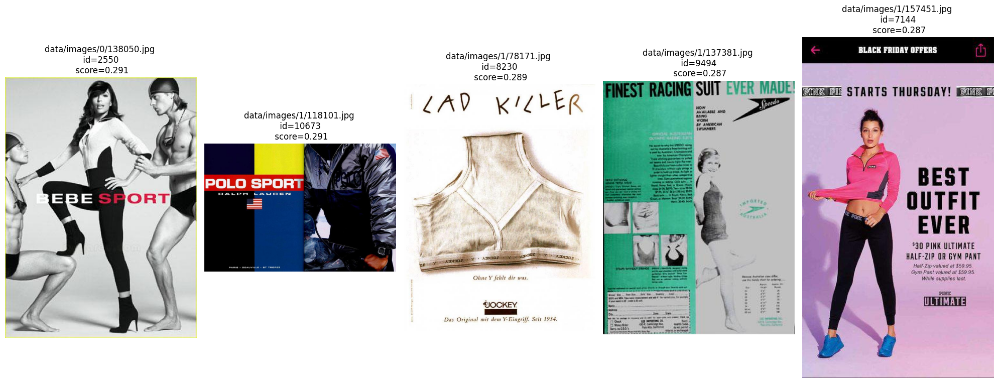

In [21]:
show_results_for_query("sportswear")

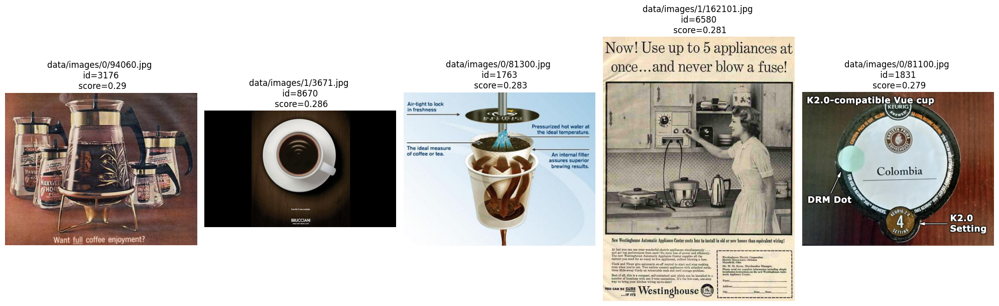

In [22]:
show_results_for_query("coffee machine")

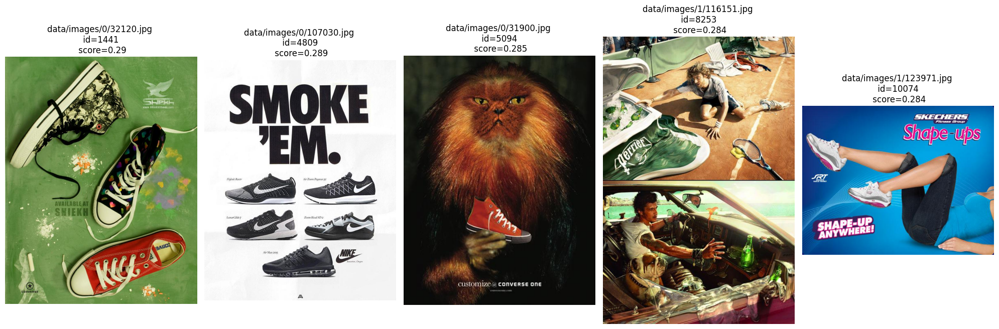

In [23]:
show_results_for_query("sneakers")

### Bad
**The solution works not so well for multi-word queries and more abstract concepts**

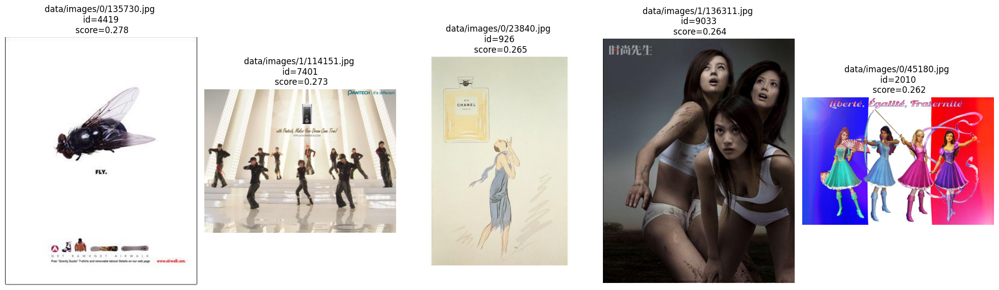

In [24]:
show_results_for_query("perfume")
# Results 2 and 3 are good but the other are irrelevant

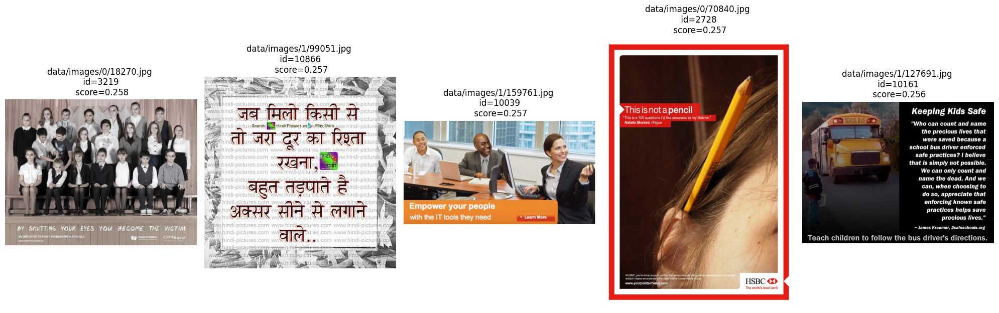

In [25]:
show_results_for_query("education")
# Although all the images look somehow related to education, the results could be better

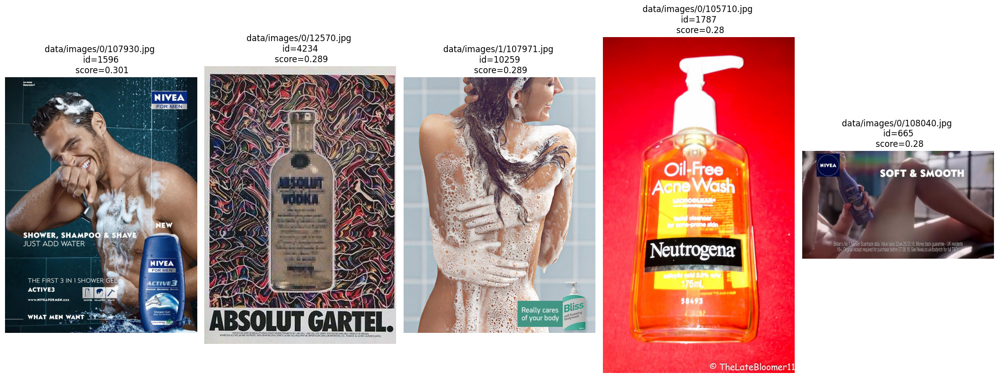

In [26]:
show_results_for_query("shower gel")
# I do not expect Absolut vodka to be in the 2nd position here

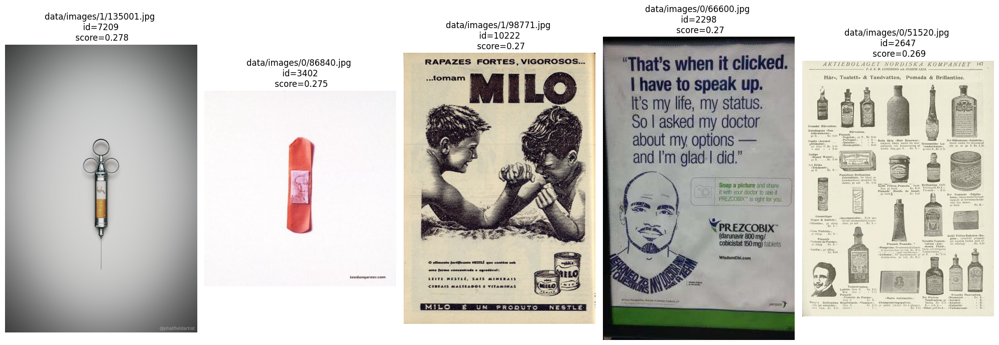

In [28]:
show_results_for_query("medicine")